In [0]:
#imports
%tensorflow_version 1.x
import cv2
from __future__ import print_function
import time
import keras
from keras.datasets import mnist
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
import numpy as np
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from keras.wrappers.scikit_learn import KerasClassifier
from keras import optimizers
from keras.constraints import maxnorm
from keras.optimizers import Nadam
import os
import random

import pandas as pd

import matplotlib 
import matplotlib.pyplot as plt
%matplotlib inline

TensorFlow 1.x selected.


Using TensorFlow backend.


In [0]:
from google.colab import drive
drive.mount('/content/drive'
)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
#read all files and replace the name of the image as the path to make future
#step easier

path = "/content/drive/My Drive/image analysis/train/"

train_label = pd.read_csv('/content/drive/My Drive/image analysis/train_labels.csv')

train_array = np.array(train_label['invasive'].iloc[: ])
train_files = []
for i in range(len(train_label)):
    train_files.append(path + str(int(train_label.iloc[i][0])) +'.jpg')
    
train_label['name'] = train_files

#train_files restore all path of training images
#train_array restore all output

train_label.head()
#check the first 5 data of train_label
#train_label.describe()

,name,invasive
0,/content/drive/My Drive/image analysis/train/1...,0
1,/content/drive/My Drive/image analysis/train/2...,0
2,/content/drive/My Drive/image analysis/train/3...,1
3,/content/drive/My Drive/image analysis/train/4...,0
4,/content/drive/My Drive/image analysis/train/5...,1


In [0]:
#read all images
#make images in a constent resolution
#resolution are set to 300*300 and 3 channels are rgb.
height = 300
width = 300
channels = 3
dim = (height, width, channels)
#read all images
from google.colab.patches import cv2_imshow
temp = []


for path in train_label.name:
    img = cv2.imread(path)
    img = cv2.resize(img, (height,width))
    img = img.astype('float32')
    temp.append(img)
train_x = np.stack(temp)

In [0]:

# Split the data
#because the training dataset are already randomness, so we can just select
#first 80% data as training and rest are validation.
x_train = train_x[:1800]
x_valid = train_x[1800:]
y_train = train_label['invasive'][:1800]
y_valid = train_label['invasive'][1800:]

In [0]:
#There are 1800 traning set and 1800 testing set
print(x_train.shape)
print(train_x.shape)
print(x_valid.shape)

(1800, 300, 300, 3)
(2295, 300, 300, 3)
(495, 300, 300, 3)


In [0]:
#normalization
#make computer better read the data
x_train /= 255
x_valid /= 255

In [0]:
#implement the VGG16 model
from keras.models import Sequential, Model, load_model
from keras import applications
from keras import optimizers
from keras.layers import Dropout, Flatten, Dense

img_rows, img_cols, img_channel = 300, 300, 3

base_model = applications.VGG16(weights='imagenet', include_top=False, input_shape=(img_rows, img_cols, img_channel))

add_model = Sequential()
add_model.add(Flatten(input_shape=base_model.output_shape[1:]))
add_model.add(Dense(256, activation='relu'))
add_model.add(Dense(1, activation='sigmoid'))
#Because this is true flase prediciton, sigmoid is the best activation function

model = Model(inputs=base_model.input, outputs=add_model(base_model.output))
model.compile(loss='binary_crossentropy', optimizer=optimizers.SGD(lr=1e-4, momentum=0.9),
              metrics=['accuracy'])

model.summary()

58892288/58889256 [==============================] - 1s 0us/step
Model: "model_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         (None, 300, 300, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 300, 300, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 300, 300, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 150, 150, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 150, 150, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 150, 150, 128)     147584    
____________________________________________________________

In [0]:
#randomly rotate and shift traning image to prevent overfitting
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint

batch_size = 32
epochs = 50

train_datagen = ImageDataGenerator(
        rotation_range=30, 
        width_shift_range=0.2,
        height_shift_range=0.2, 
        horizontal_flip=True)
train_datagen.fit(x_train)

#model.fit(x_train, y_train, batch_size=batch_size,epochs=epochs,verbose=1,callbacks=[ModelCheckpoint('VGG16-transferlearning.model', monitor='val_acc', save_best_only=True)],validation_data=(x_valid, y_valid))


In [0]:

history = model.fit_generator(
    train_datagen.flow(x_train, y_train, batch_size=batch_size),
    steps_per_epoch=x_train.shape[0] // batch_size,
    epochs=epochs,
    validation_data=(x_valid, y_valid),
    callbacks=[ModelCheckpoint('VGG16-transferlearning.model', monitor='val_acc', save_best_only=True)]
)

Epoch 1/50
56/56 [==============================] - 120s 2s/step - loss: 0.5398 - acc: 0.7379 - val_loss: 0.3320 - val_acc: 0.8545
Epoch 2/50
56/56 [==============================] - 95s 2s/step - loss: 0.2774 - acc: 0.8806 - val_loss: 0.2387 - val_acc: 0.9192
Epoch 3/50
56/56 [==============================] - 95s 2s/step - loss: 0.2353 - acc: 0.9068 - val_loss: 0.2127 - val_acc: 0.9131
Epoch 4/50
56/56 [==============================] - 95s 2s/step - loss: 0.1981 - acc: 0.9197 - val_loss: 0.1807 - val_acc: 0.9354
Epoch 5/50
56/56 [==============================] - 96s 2s/step - loss: 0.1648 - acc: 0.9308 - val_loss: 0.1786 - val_acc: 0.9273
Epoch 6/50
56/56 [==============================] - 94s 2s/step - loss: 0.2483 - acc: 0.9041 - val_loss: 0.1931 - val_acc: 0.9273
Epoch 7/50
56/56 [==============================] - 95s 2s/step - loss: 0.1554 - acc: 0.9386 - val_loss: 0.1638 - val_acc: 0.9313
Epoch 8/50
56/56 [==============================] - 95s 2s/step - loss: 0.1519 - acc: 0.9

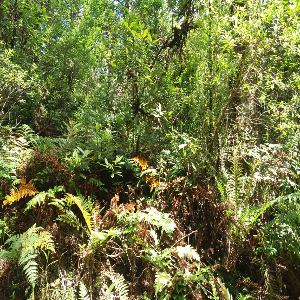

flase


In [0]:
img = cv2.imread('/content/drive/My Drive/image analysis/test/328.jpg')
img = cv2.resize(img, (300,300))
img = img.astype('float32')
cv2_imshow(img)
img /=255
if model.predict(np.array( [img,] ) ) > 0.97:
  print("true")
else:
  print("flase")


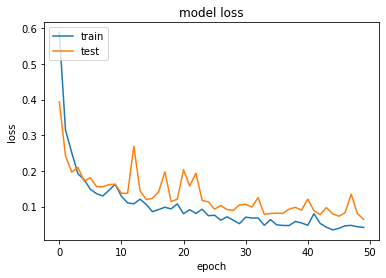

In [0]:
#loss curve
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

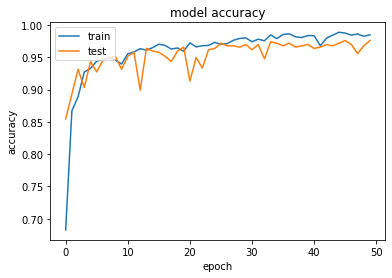

In [0]:
# summarize history for accuracy
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [0]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc 

# Plot an ROC. pred - the predictions, y - the expected output.
def plot_roc(pred,y):
    fpr, tpr, _ = roc_curve(y, pred)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    plt.show()

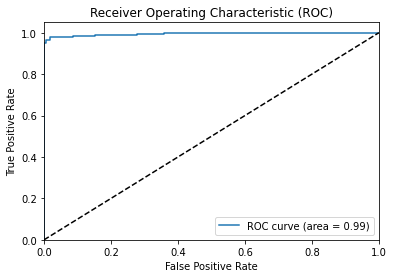

In [87]:
pred = model.predict(x_valid)
plot_roc(pred,y_valid)

# **ResNet50**

In [0]:

import os
import numpy as np
import pandas as pd

from keras.preprocessing import image
from keras.layers import Dense, GlobalAveragePooling2D
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
from keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint
from keras.layers import Dropout
# from PIL import ImageFile
from keras.applications.resnet50 import ResNet50

base_model = ResNet50(weights='imagenet', include_top=False, input_shape= (300, 300, 3))
model = base_model.output

#Global average pooling do a slightly better job than maximum pooling here
model = GlobalAveragePooling2D(name='globalaveragepooling2d')(model)
#two dense layer are applied
model = Dense(1024, activation='relu',name='Dense_1')(model)
model = Dropout(0.5, name='dropout_1')(model)
model = Dense(256, activation='relu',name='Dense_2')(model)
model = Dropout(0.5, name='dropout_2')(model)
predictions = Dense(1, activation='sigmoid',name='output')(model)
    
model_resnet = Model(inputs=base_model.input, outputs=predictions)
    
print(model_resnet.summary())

/usr/local/lib/python3.6/dist-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 300, 300, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 306, 306, 3)  0           input_5[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 150, 150, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 150, 150, 64) 256         conv1[0][0]                      
____________________________________________________________________________________________

In [0]:
def save_model_to_json(model,model_save_path):
    model_json = model_resnet.to_json()
    with open(model_save_path, 'w') as json_file:
        json_file.write(model_json)
    print('model saved')


model_save_path = './model.json'
save_model_to_json(model,model_save_path)


model saved


In [0]:
# frozen the first 15 layers
for layer in model_resnet.layers[:175]:
    layer.trainable = False
for layer in model_resnet.layers[175:]:
    layer.trainable = True

# compile the model
model_resnet.compile(optimizer=SGD(lr=0.0001, momentum=0.9), loss='binary_crossentropy', metrics=['accuracy'])

# set train Generator
datagen = ImageDataGenerator(rotation_range=30,width_shift_range=0.2,height_shift_range=0.2,horizontal_flip=True)
datagen.fit(x_train)

# trainning process
nb_epoch = 5
batch_size = 32
checkpointer = ModelCheckpoint(filepath= './ResNet50_weights.hdf5', verbose=1, monitor='val_acc',save_best_only=True, save_weights_only=True)
model_resnet.fit_generator(datagen.flow(x_train, y_train, batch_size=batch_size),
                    steps_per_epoch = x_train.shape[0],
                    epochs=nb_epoch,
                    callbacks=[checkpointer])
#Due to the performance of the GPU, this model take extremely long to train

Epoch 1/5
1800/1800 [==============================] - 1179s 655ms/step - loss: 0.4244 - acc: 0.7934
Epoch 2/5


/usr/local/lib/python3.6/dist-packages/keras/callbacks.py:707: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


1800/1800 [==============================] - 1172s 651ms/step - loss: 0.2951 - acc: 0.8672
Epoch 3/5
1800/1800 [==============================] - 1173s 652ms/step - loss: 0.2572 - acc: 0.8873
Epoch 4/5
1800/1800 [==============================] - 1181s 656ms/step - loss: 0.2297 - acc: 0.9010
Epoch 5/5
1800/1800 [==============================] - 1178s 655ms/step - loss: 0.2164 - acc: 0.9066


In [0]:
preds = model_resnet.evaluate(x_valid, y_valid)
print ("Loss = " + str(preds[0]))
print ("Test Accuracy = " + str(preds[1]))

Loss = 0.2164535352323
Test Accuracy = 0.91371715189279185


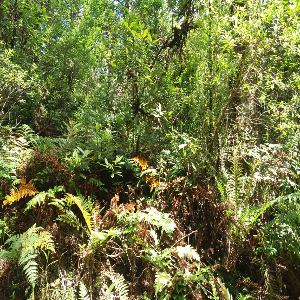

flase


In [0]:
img = cv2.imread('/content/drive/My Drive/image analysis/test/328.jpg')
img = cv2.resize(img, (300,300))
img = img.astype('float32')
cv2_imshow(img)
img /=255
if model_resnet.predict(np.array( [img,] ) ) > 0.97:
  print("true")
else:
  print("flase")


# **Inception V3**

In [0]:
import cv2
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn import metrics
import keras
from keras.models import Model
from keras.optimizers import Adam
from keras import applications
from keras.applications.inception_v3 import InceptionV3
from keras.layers import Dense, Input, Flatten, Dropout, GlobalAveragePooling2D
from keras.layers.normalization import BatchNormalization
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
img_rows, img_cols, img_channel = 300, 300, 3
img_dim = (img_rows, img_cols, img_channel)
base_model = applications.inception_v3.InceptionV3(include_top=False, weights='imagenet',pooling='avg', input_shape=(img_rows, img_cols, img_channel))

add_model = Sequential()
add_model.add(Dense(1024, activation='relu',input_shape=base_model.output_shape[1:]))
add_model.add(Dropout(0.60))
add_model.add(Dense(1, activation='sigmoid'))


In [0]:
model_v3 = Model(inputs=base_model.input, outputs=add_model(base_model.output))
optimizer = optimizers.adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
reduce_lr = ReduceLROnPlateau(monitor='val_acc',
                              patience=5,
                              verbose=1,
                              factor=0.1,
                              cooldown=10,
                              min_lr=0.00001) 
model_v3.compile(loss = 'binary_crossentropy', optimizer = optimizer, metrics=['accuracy'])
print(model_v3.summary())

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            (None, 300, 300, 3)  0                                            
__________________________________________________________________________________________________
conv2d_95 (Conv2D)              (None, 149, 149, 32) 864         input_8[0][0]                    
__________________________________________________________________________________________________
batch_normalization_95 (BatchNo (None, 149, 149, 32) 96          conv2d_95[0][0]                  
__________________________________________________________________________________________________
activation_340 (Activation)     (None, 149, 149, 32) 0           batch_normalization_95[0][0]     
____________________________________________________________________________________________

In [0]:
batch_size = 32
epochs = 50


history_v3 = model_v3.fit_generator(train_datagen.flow(x_train, y_train, batch_size=batch_size),
            validation_data = (x_valid, y_valid), callbacks=[reduce_lr],
            steps_per_epoch = len(x_train) / 64, epochs = epochs, verbose = 2)
 

Epoch 1/50
 - 72s - loss: 0.6908 - acc: 0.6756 - val_loss: 1.9449 - val_acc: 0.6283
Epoch 2/50
 - 38s - loss: 0.3513 - acc: 0.8438 - val_loss: 4.7431 - val_acc: 0.6364
Epoch 3/50
 - 38s - loss: 0.2457 - acc: 0.9170 - val_loss: 1.2070 - val_acc: 0.8040
Epoch 4/50
 - 37s - loss: 0.2251 - acc: 0.9246 - val_loss: 1.6869 - val_acc: 0.8061
Epoch 5/50
 - 37s - loss: 0.1914 - acc: 0.9364 - val_loss: 1.5954 - val_acc: 0.7657
Epoch 6/50
 - 38s - loss: 0.1383 - acc: 0.9494 - val_loss: 0.6441 - val_acc: 0.7939
Epoch 7/50
 - 40s - loss: 0.1333 - acc: 0.9537 - val_loss: 0.6640 - val_acc: 0.8889
Epoch 8/50
 - 37s - loss: 0.1544 - acc: 0.9440 - val_loss: 0.2641 - val_acc: 0.9152
Epoch 9/50
 - 38s - loss: 0.1393 - acc: 0.9483 - val_loss: 0.4717 - val_acc: 0.9253
Epoch 10/50
 - 38s - loss: 0.1227 - acc: 0.9558 - val_loss: 2.9748 - val_acc: 0.6869
Epoch 11/50
 - 37s - loss: 0.0636 - acc: 0.9763 - val_loss: 3.9140 - val_acc: 0.6566
Epoch 12/50
 - 38s - loss: 0.0955 - acc: 0.9677 - val_loss: 0.1807 - val_a

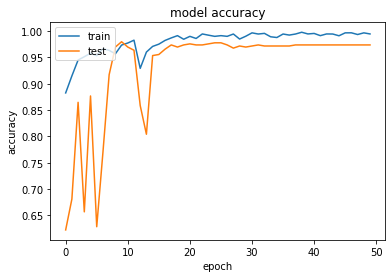

In [0]:
# summarize history for accuracy
plt.plot(history_v3.history['acc'])
plt.plot(history_v3.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

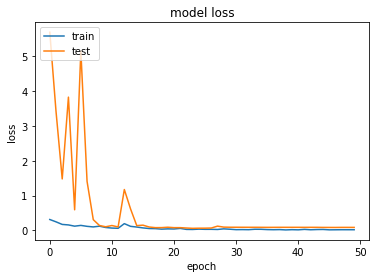

In [0]:
#loss curve
plt.plot(history_v3.history['loss'])
plt.plot(history_v3.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

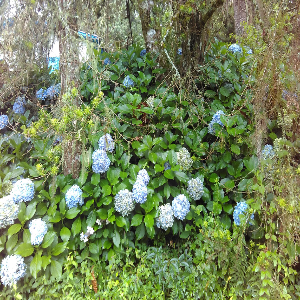

true


In [0]:
img = cv2.imread('/content/drive/My Drive/image analysis/test/232.jpg')
img = cv2.resize(img, (300,300))
img = img.astype('float32')
cv2_imshow(img)
img /=255
if model_v3.predict(np.array( [img,] ) ) >0.97 1:
  print("true")
else:
  print("flase")


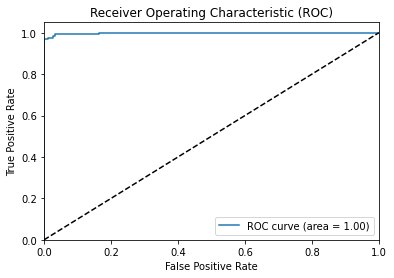

In [89]:
pred = model_v3.predict(x_valid)
plot_roc(pred,y_valid)

# **Emsembled system--Majority voting**

In [0]:
#using majority voting to combine three models
def prediction_es(img):
    pred_v3=model.predict(np.array( [img,] ) )>0.97
    pred_xgg=model_v3.predict(np.array( [img,] ) )>0.97
    pred_resnet=model_resnet(np.array( [img,] ) )>0.97
    pred_final=int(pred_v3)+int(pred_xgg)+int(pred_resnet)>=2
    return pred_final

In [204]:
#Analysis the accuracy of ensemble system
pred_combine = np.array([])
#the length of y_valid is 495
for i in range(len(y_valid)):
  pred_combine = np.append(pred_combine,int(prediction_es(x_valid[i])))

accuracy=np.sum(pred_combine==np.array(y_valid))/len(y_valid)

print("The Accuracy of ensembled model is: "+ str(accuracy))

The Accuracy of ensembled model is: 0.9854771784232366


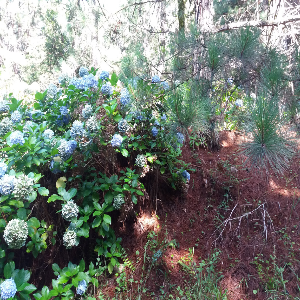

True

In [145]:
img = cv2.imread('/content/drive/My Drive/image analysis/test/732.jpg')
img = cv2.resize(img, (300,300))
img = img.astype('float32')
cv2_imshow(img)
img /=255
prediction_es(img)

# **TESTING of upload photos**

Saving 739.jpg to 739.jpg


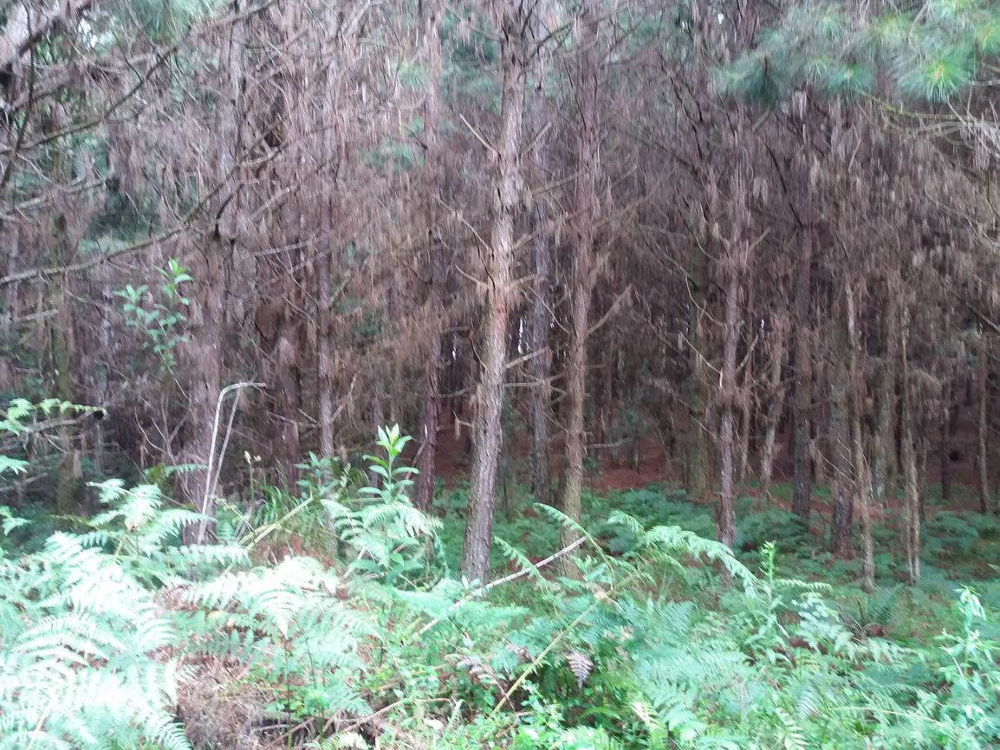

VGG16:flase
inception V3:flase
ResNet 50:flase


Saving 1183.jpg to 1183.jpg


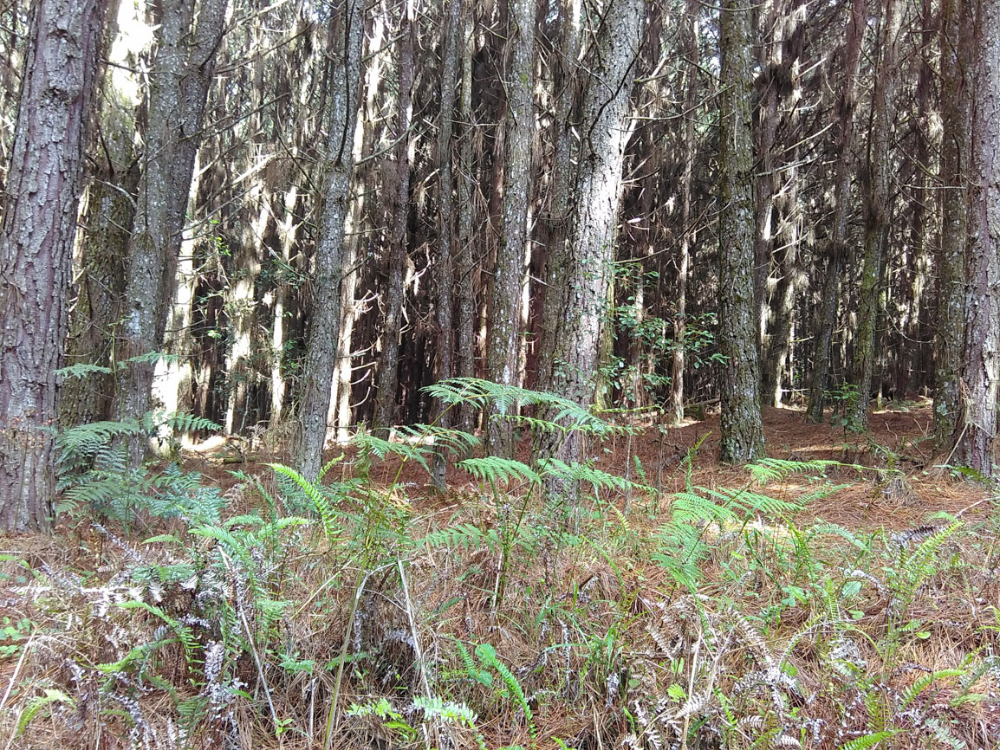

VGG16:flase
inception V3:flase
ResNet 50:flase


Saving 1077.jpg to 1077.jpg


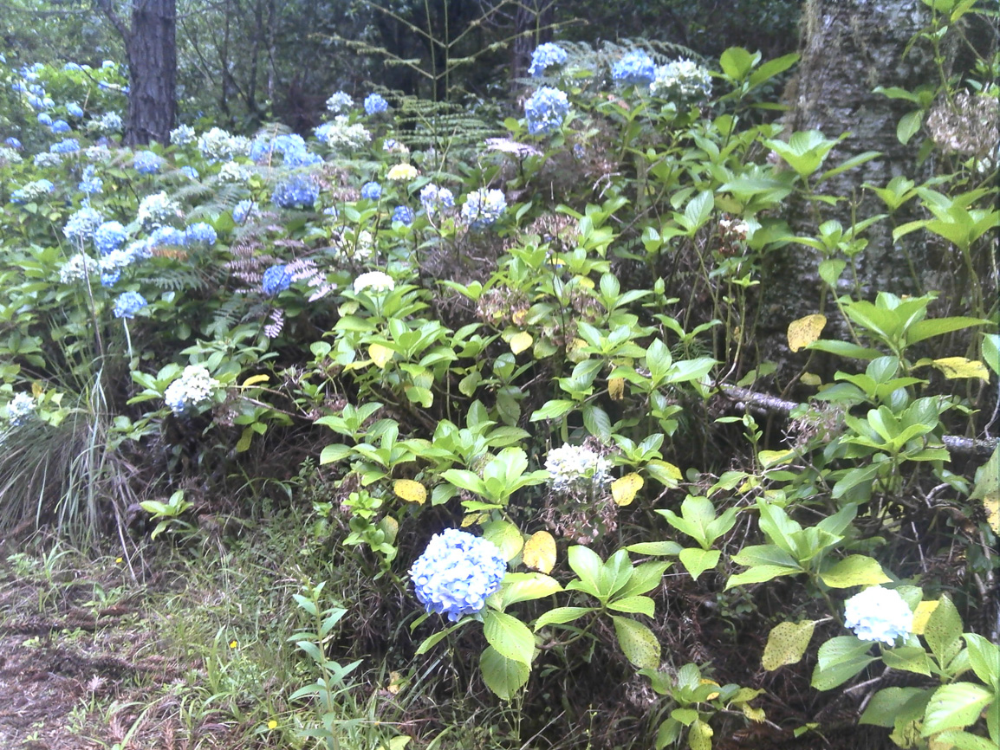

VGG16:true
inception V3:true
ResNet 50:true


Saving 1013.jpg to 1013.jpg


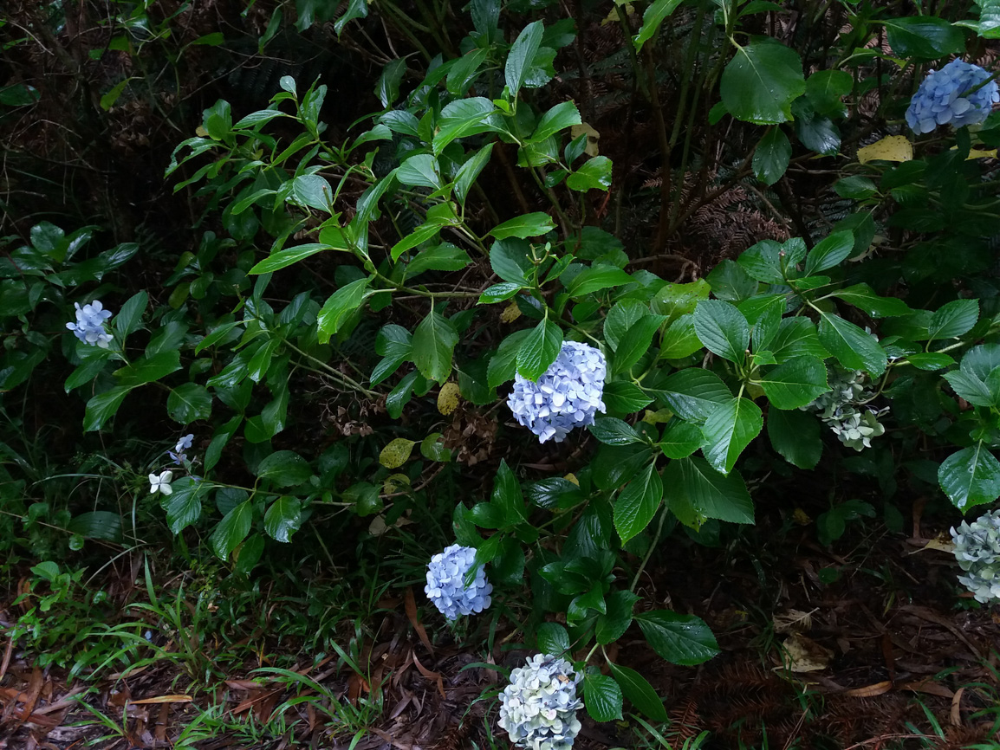

VGG16:true
inception V3:true
ResNet 50:true


Saving 1457.jpg to 1457.jpg


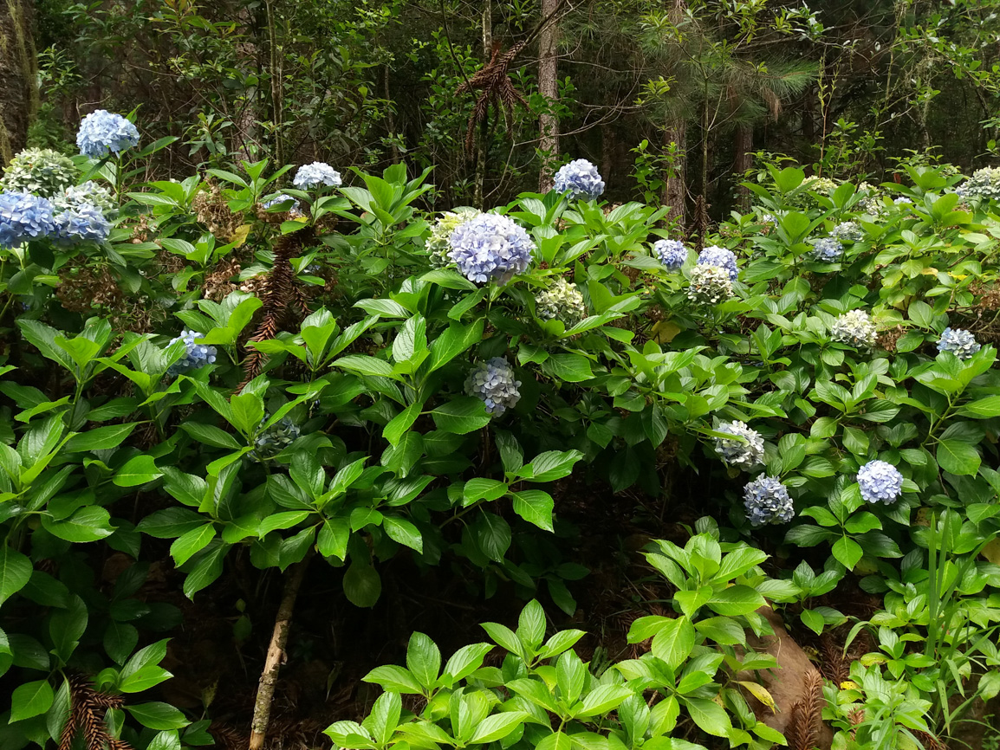

VGG16:true
inception V3:true
ResNet 50:true


Saving 1428.jpg to 1428.jpg


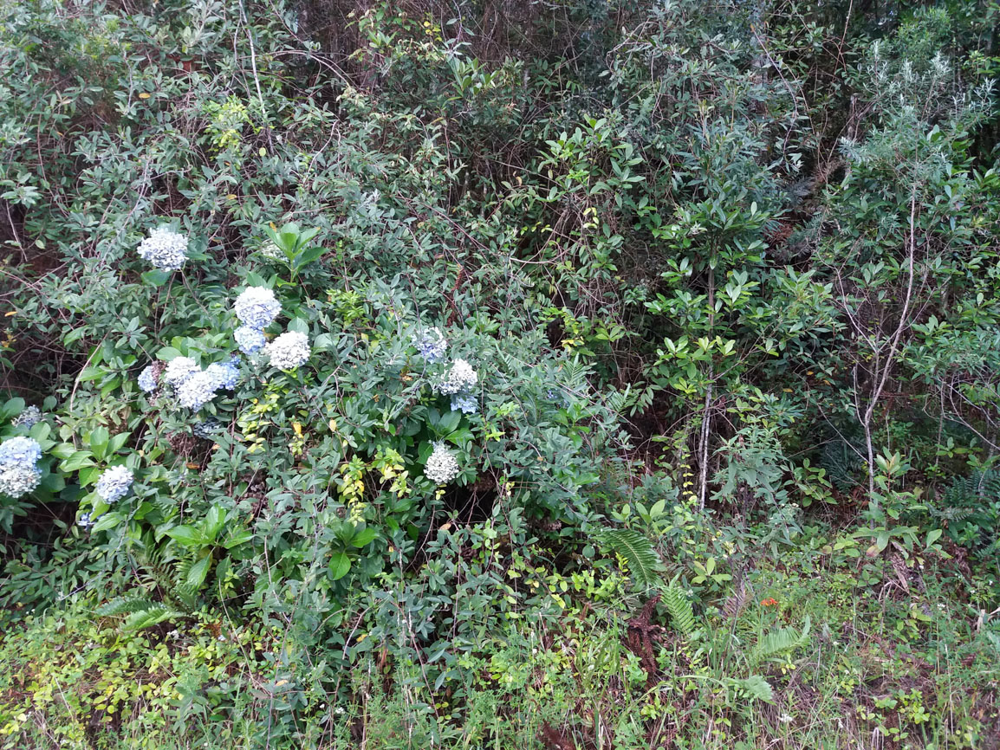

VGG16:true
inception V3:true
ResNet 50:true


Saving 1403.jpg to 1403.jpg


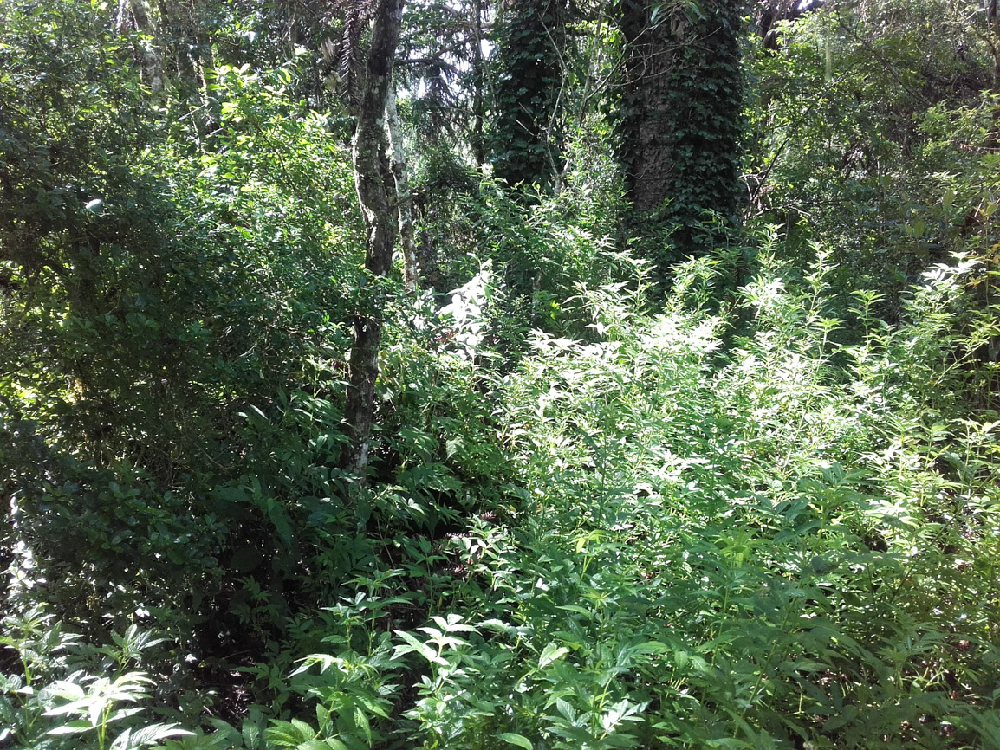

VGG16:flase
inception V3:flase
ResNet 50:flase


Saving 967.jpg to 967.jpg


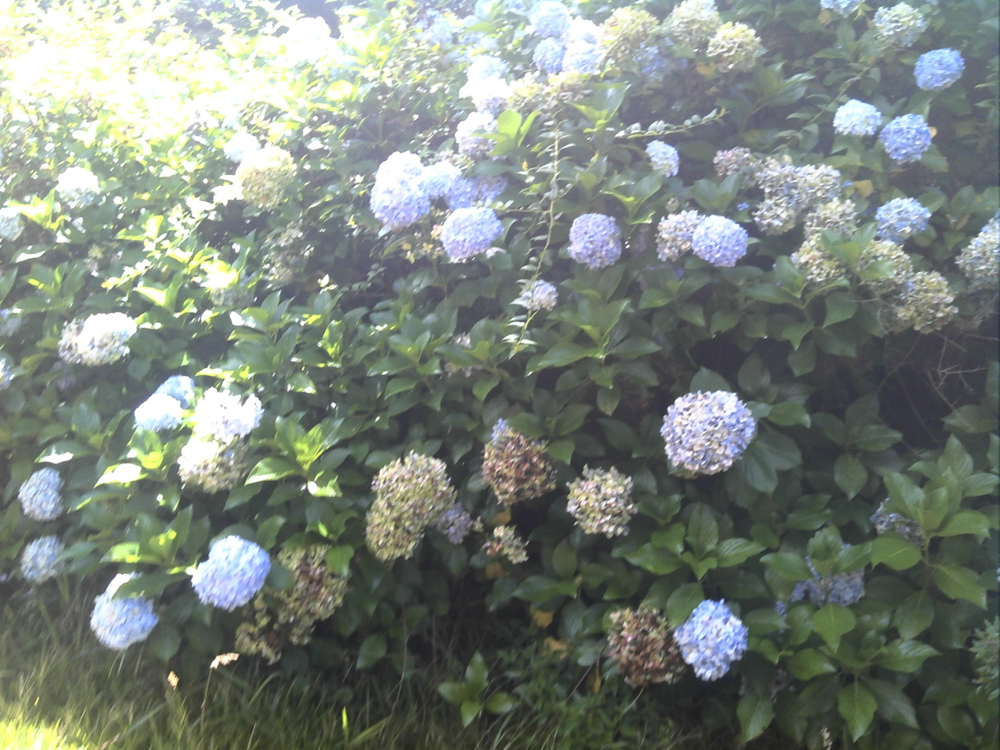

VGG16:true
inception V3:true
ResNet 50:true


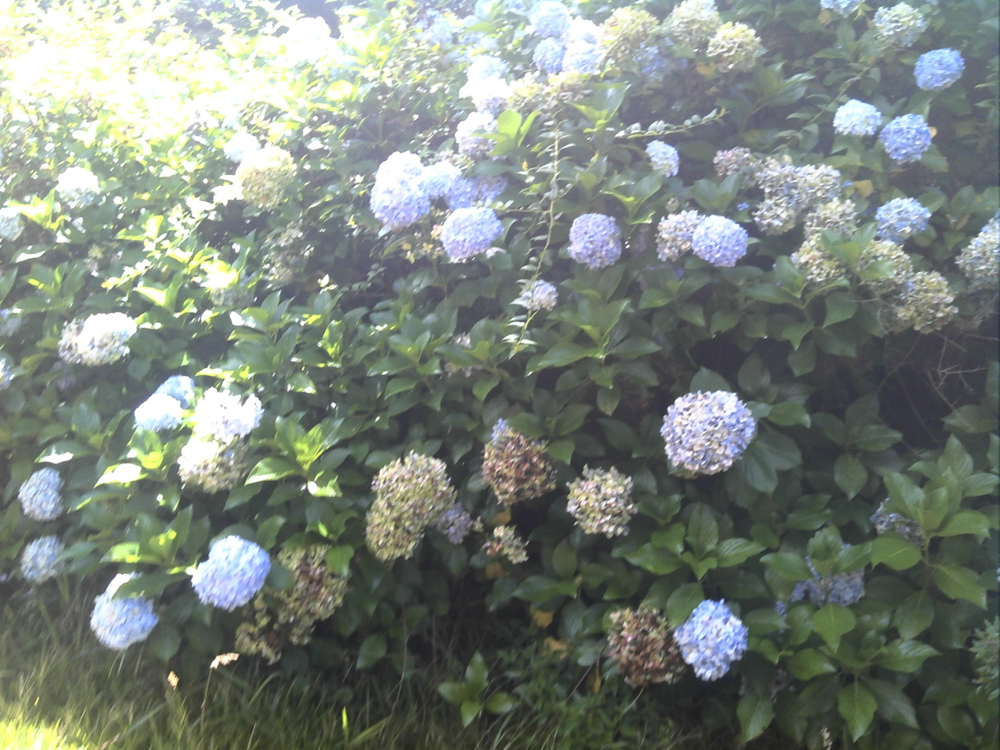

VGG16:true
inception V3:true
ResNet 50:true


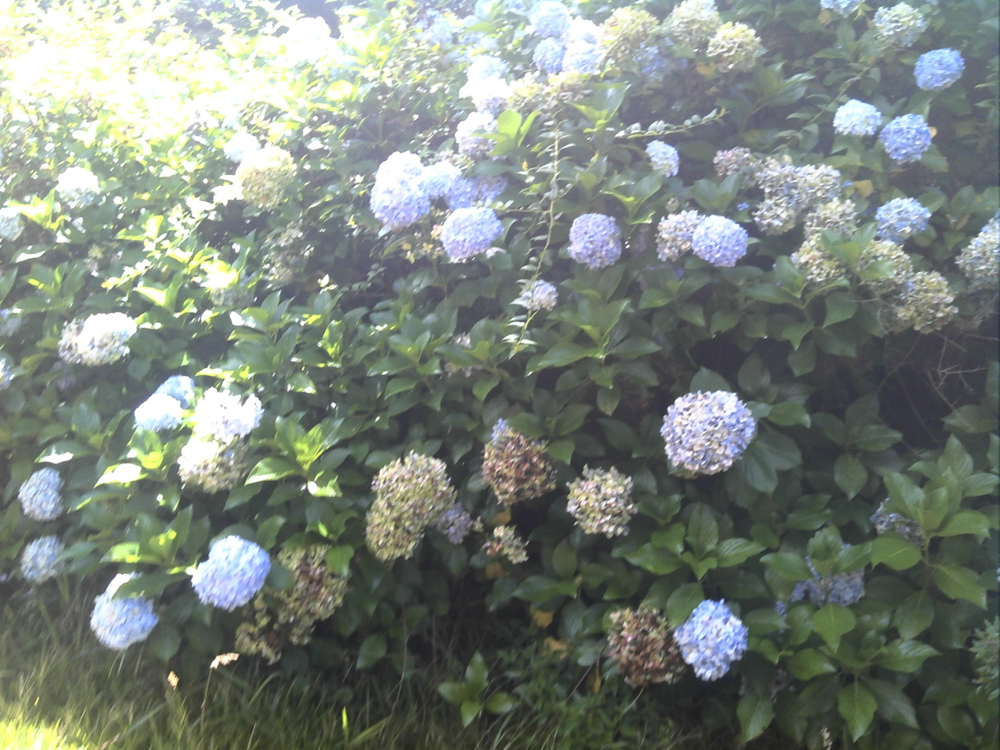

VGG16:true
inception V3:true
ResNet 50:true


KeyboardInterrupt: ignored

In [101]:
#Uploading image to test
from google.colab import files
from PIL import Image
from IPython.display import clear_output
while 1:
  upload = files.upload()
  for fn in upload.keys():
    filename = '/content/'+fn
#Output Image and prediction results
  img = cv2.imread(filename)
  cv2_imshow(img)
  img = cv2.resize(img, (300,300))
  img = img.astype('float32')
  img /=255
#VGG16
  if model.predict(np.array( [img,] ) ) > 0.97:
    print("VGG16:true")
  else:
    print("VGG16:flase")
#inception V3
  if model_v3.predict(np.array( [img,] ) ) > 0.97:
    print("inception V3:true")
  else:
    print("inception V3:flase")
#ResNet 50
  if model_resnet.predict(np.array( [img,] ) )> 0.97:
    print("ResNet 50:true")
  else:
    print("ResNet 50:flase")




# **Camera detection**

In [0]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=1.0):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      //const capture = document.createElement('button');
      //capture.textContent = 'Capture';
      //div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      //await new Promise((resolve) => capture.onclick = resolve);
      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [123]:
from IPython.display import Image
from google.colab import output
import sys
while True:
  filename = take_photo()
  # Show the image which was just taken.
  img = cv2.imread('/content/photo.jpg')
  img = cv2.resize(img, (300,300))
  img = img.astype('float32')
  #cv2_imshow(img)
  img /=255
  output.clear()
  if model.predict(np.array( [img,] ) ) > 0.97:
    sys.stdout.write('VGG16: True\n')
  else:
    sys.stdout.write('VGG16: Flase\n')
  if model_v3.predict(np.array( [img,] ) ) > 0.97:
    sys.stdout.write('Inception V3: True\n')
  else:
    sys.stdout.write('Inception V3: Flase\n')
  if model_resnet.predict(np.array( [img,] ) )> 0.97:
    sys.stdout.write('ResNet 50: True\n')
  else:
    sys.stdout.write('ResNet 50: Flase\n')

VGG16: Flase
Inception V3: Flase
ResNet 50: Flase


<IPython.core.display.Javascript object>

KeyboardInterrupt: ignored